# AppGPS AppGPS_EDA_Visualization
#### A Sentimental Analysis of App-Users from the category communication in the Google Play Store aka GPS


### 1. Import Libraries and Dataset
### 2. Data Cleaning and Standardization - Second Round!
### 3. Data Exploration - Second Round!
### 4. Dealing with the Polarity of Reviews' Text
### 5. Dealing with the Representative Words in Reviews' Text
### 6. Sources 




### 1. Import Libraries and Dataset

In [31]:
import numpy as np
import pandas as pd
# For visualizations
import matplotlib.pyplot as plt
from matplotlib.colors import BASE_COLORS
%matplotlib inline
import seaborn as sns
sns.set_theme(style="ticks", color_codes=True)

# For regular expressions
import re
# For handling string
import string
# For performing mathematical operations
import math
# For perfomance tracking 
from tqdm.notebook import trange, tqdm


# For tokenazing the text with Python
import spacy
# For Document Term Matrix
from sklearn.feature_extraction.text import CountVectorizer 

import nltk
# For counting unique words
from collections import Counter

import warnings
warnings.filterwarnings('ignore')

from datetime import datetime
import pickle

In [32]:
data = pd.read_csv("lematized_data.csv") 

In [33]:
data.shape

(46114, 6)

### 2. Data Cleaning and Standardization - Second Round!


In [34]:
# After cleaning and lemmatized the text some reviews showl lost all the content becomming then nul and missing values 
# we need to delete them  
df = data.dropna(how='any', subset=['lemmatized'], axis=0)

In [35]:
df.shape

(45609, 6)

In [36]:
# cretae a target for sentiment analysis
df['label'] = df['score'].apply(lambda x: 'Positive' if x > 3 else('Neutral' if x == 3  else 'Negative'))


In [37]:
df.head()

,score,thumbsupcount,at,appid,content,lemmatized,label
0,1,881,2021-03-05 10:53:50,com.android.chrome,just got the update and now chrome has just st...,get update chrome stop work reason try clear c...,Negative
1,1,570,2021-03-06 20:56:06,com.android.chrome,i used to love this but the grouped tabs are i...,love group tab illogical add extra click want ...,Negative
2,1,31,2021-03-05 19:19:02,com.android.chrome,i was super happy with chrome for android this...,super happy chrome android change immediately ...,Negative
3,1,148,2021-03-04 09:21:44,com.android.chrome,when i enter google on my phone and enter a ce...,enter google phone enter certain site switch g...,Negative
4,1,41,2021-03-05 13:20:29,com.android.chrome,the new update is total bs the tab layout is t...,new update total bs tab layout totally mess ch...,Negative


In [38]:
df["score"].value_counts()

3    14222
1     8659
5     7718
2     7561
4     7449
Name: score, dtype: int64

In [39]:
# Format the Datatime
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45609 entries, 0 to 46113
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   score          45609 non-null  int64 
 1   thumbsupcount  45609 non-null  int64 
 2   at             45609 non-null  object
 3   appid          45609 non-null  object
 4   content        45609 non-null  object
 5   lemmatized     45609 non-null  object
 6   label          45609 non-null  object
dtypes: int64(2), object(5)
memory usage: 2.8+ MB


In [40]:
df['at'] = pd.to_datetime(df['at'], errors='coerce')
df.dtypes

score                     int64
thumbsupcount             int64
at               datetime64[ns]
appid                    object
content                  object
lemmatized               object
label                    object
dtype: object

In [41]:
from datetime import datetime

In [42]:
# change timeseries to datetime

In [43]:
df['at'] = pd.to_datetime(df['at'])

In [44]:
df['date'] = df['at'].dt.date

In [45]:
df.head()

,score,thumbsupcount,at,appid,content,lemmatized,label,date
0,1,881,2021-03-05 10:53:50,com.android.chrome,just got the update and now chrome has just st...,get update chrome stop work reason try clear c...,Negative,2021-03-05
1,1,570,2021-03-06 20:56:06,com.android.chrome,i used to love this but the grouped tabs are i...,love group tab illogical add extra click want ...,Negative,2021-03-06
2,1,31,2021-03-05 19:19:02,com.android.chrome,i was super happy with chrome for android this...,super happy chrome android change immediately ...,Negative,2021-03-05
3,1,148,2021-03-04 09:21:44,com.android.chrome,when i enter google on my phone and enter a ce...,enter google phone enter certain site switch g...,Negative,2021-03-04
4,1,41,2021-03-05 13:20:29,com.android.chrome,the new update is total bs the tab layout is t...,new update total bs tab layout totally mess ch...,Negative,2021-03-05


In [46]:
oldest_review = df['date'].min()
last_review = df['date'].max()
print (f"Period of the reviews between {oldest_review} and {last_review}. ")

Period of the reviews between 2013-09-08 and 2021-03-08. 


In [47]:
df.tail()

,score,thumbsupcount,at,appid,content,lemmatized,label,date
46109,5,0,2021-03-05 07:54:09,com.asiainno.uplive.aiglamour,it is too good,good,Positive,2021-03-05
46110,5,0,2021-03-05 06:58:33,com.asiainno.uplive.aiglamour,good fun,good fun,Positive,2021-03-05
46111,5,0,2021-03-05 06:56:05,com.asiainno.uplive.aiglamour,noyon,noyon,Positive,2021-03-05
46112,5,0,2021-03-05 06:17:48,com.asiainno.uplive.aiglamour,nice free app,nice free app,Positive,2021-03-05
46113,5,0,2021-03-05 03:40:12,com.asiainno.uplive.aiglamour,fast time,fast time,Positive,2021-03-05


In [48]:
df = df.drop(columns=["at", "content"])

In [49]:
df.head()

,score,thumbsupcount,appid,lemmatized,label,date
0,1,881,com.android.chrome,get update chrome stop work reason try clear c...,Negative,2021-03-05
1,1,570,com.android.chrome,love group tab illogical add extra click want ...,Negative,2021-03-06
2,1,31,com.android.chrome,super happy chrome android change immediately ...,Negative,2021-03-05
3,1,148,com.android.chrome,enter google phone enter certain site switch g...,Negative,2021-03-04
4,1,41,com.android.chrome,new update total bs tab layout totally mess ch...,Negative,2021-03-05


In [50]:
# Format the Name 

In [51]:

dict = {"com.android.chrome": "Google Chrome", "com.microsoft.office.outlook": "Microsoft Outlook",
"jp.naver.line.android": "LINE-Free Calls ",
 "org.thoughtcrime.securesms": "Signal Messenger",
 "sg.bigo.live": "Hello Yo Chat",
 "com.yahoo.mobile.client.android.mail": "Yahoo Mail",
 "com.facebook.orca": "Messenger",
 "com.discord": "Discord-Talk",
 "com.truecaller": "Truecaller",
 "com.viber.voip": "Viber-Messenger",
 "com.whatsapp": "WhatsApp",
 "com.google.android.apps.tachyon": "Google Duo",
 "com.enflick.android.TextNow": "TextNow",
 "com.google.android.apps.meetings": "Google Meet",
 "com.snapchat.android" : "Snapchat",
 "com.duckduckgo.mobile.android": "DuckDuckGo",
 "com.plato.android": "Plato-Games ",
 "com.google.android.gm": "GMail",
 "com.whatsapp.w4b": "WhatsApp-Business",
 "com.google.android.apps.messaging": "Messages",
 "com.skype.raider" : "skype",
 "com.chat.ruletka": "Chatruletka",
 "com.google.android.apps.searchlite": "Google Go",
 "com.facebook.mlite": "Messenger Lite",
 "org.mozilla.firefox": "Firefox",
 "com.microsoft.emmx": "Microsoft Edge",
 "com.sec.android.app.sbrowser": "Samsung Browser",
 "com.samsung.android.email.provider": "Samsung Email",
 "org.telegram.messenger": "Telegram",
 "sg.bigo.hellotalk": "Hello Yo Chat",
 "com.facebook.talk": "Messenger Kids",
 "ru.mail.mailapp" : "Mail.ru - Email ",
 "net.idt.um.android.bossrevapp": "BOSS Calls",
 "com.callapp.contacts": "CallApp",
 "com.google.android.apps.googlevoice": "Google Voice",
 "omegle.tv": "OmeTV ",
 "com.hsv.freeadblockerbrowser": "Adblocker Browser",
 "com.google.android.talk": "Hangouts",
 "com.pinger.textfree": "Text Free Call ",
 "com.yandex.browser" : "Yandex Browser",
 "com.gotomeeting": "GoToMeeting" ,
 "ru.yandex.mail": "Yandex Mail",
 "com.loudtalks": "Zello Talk", 
 "com.google.android.contacts": "Contacts Google",
 "com.videochat.livu": "LivU Chat",
 "com.weieyu.yalla": "Yalla Chat",
 "com.cisco.webex.meetings": "Webex",
 "com.textmeinc.textme":"Text Me",
 "ch.protonmail.android": "ProtonMail", "com.asiainno.uplive.aiglamour": "Lamour-Chat" }


In [52]:
# change the name of the apps
df['appid']= df['appid'].map(dict) 

In [53]:
df.head(1)

,score,thumbsupcount,appid,lemmatized,label,date
0,1,881,Google Chrome,get update chrome stop work reason try clear c...,Negative,2021-03-05


 ### Data Exploration

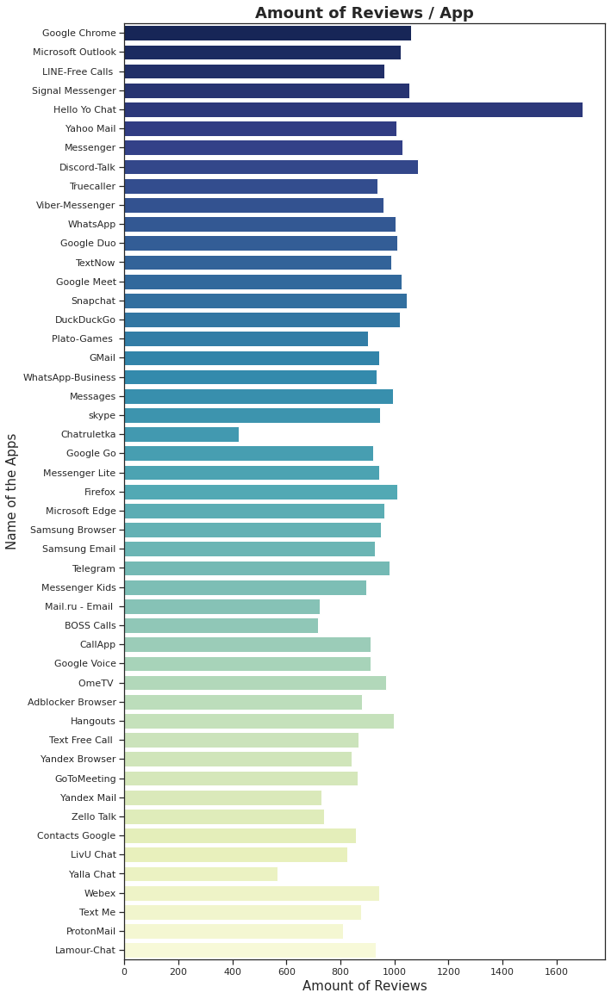

In [54]:
# Ploting the amount of reviews per app 
countplt, ax = plt.subplots(figsize = (10,20))
ax =sns.countplot(y = 'appid', data=df, palette='YlGnBu_r')

# Chart and axes titles
ax.set_title('Amount of Reviews / App',fontsize = 18, fontweight='bold' )
ax.set_xlabel('Amount of Reviews', fontsize = 15)
ax.set_ylabel('Name of the Apps', fontsize = 15)
plt.savefig('apps_plot.png', dpi=100)

Text(0, 0.5, 'Amount of Reviews')

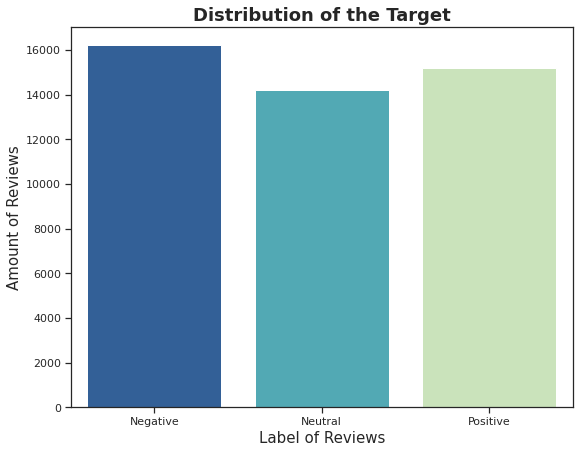

In [55]:
# Plot the distribution of the cleaned data
countplt, ax = plt.subplots(figsize = (9,7))
ax =sns.countplot(x = 'label', data=df, palette='YlGnBu_r')

# Chart and axes titles
ax.set_title('Distribution of the Target',fontsize = 18, fontweight='bold' )
ax.set_xlabel('Label of Reviews', fontsize = 15)
ax.set_ylabel('Amount of Reviews', fontsize = 15)



Text(0, 0.5, 'Amount of Reviews')

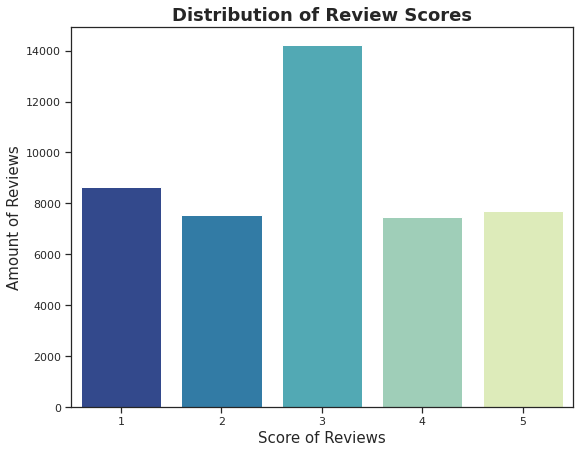

In [56]:
# Plot the scores of the cleaned data

countplt, ax = plt.subplots(figsize = (9,7))
ax =sns.countplot(x = 'score', data=df, palette='YlGnBu_r')

# Chart and axes titles
ax.set_title('Distribution of Review Scores',fontsize = 18, fontweight='bold' )
ax.set_xlabel('Score of Reviews', fontsize = 15)
ax.set_ylabel('Amount of Reviews', fontsize = 15)



After cleaning the text we get 16220 negative reviews. They are 1053 more than the positives review.
Having a sample of 45609 reviews, this is a difference of 2.3% and may not play a strong role in biasing the performance of a model.
* *Negative*
    * 1     8659
    * 2     7561

* *Neutral*
    * 3     14222

* *Positive*
    * 4     7449
    * 5     7718

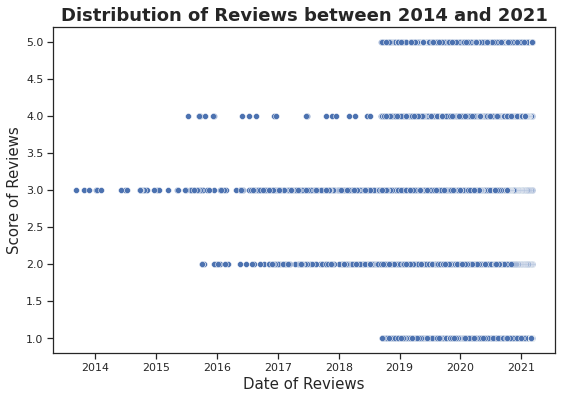

In [58]:
# Plot the Distribution of the Reviews between 2014 and 2021
#(period when the reviews were posted in GPS)

# Set figure size (width, height) in inches 
plt.figure(figsize = ( 9 , 6 )) 
  
# Plot scatterplot 
sns.scatterplot( x = "date" , y = "score" , data = df , palette='YlGnBu_r') 
  
# Set label for x-axis 
plt.xlabel(  "Date of Reviews" , size = 15 ) 
  
# Set label for y-axis 
plt.ylabel("Score of Reviews" , size = 15 ) 
  
# Set title for figure 
plt.title( "Distribution of Reviews between 2014 and 2021" , size = 18, fontweight = 'bold' ) 
  
# Display figure 
plt.show() 


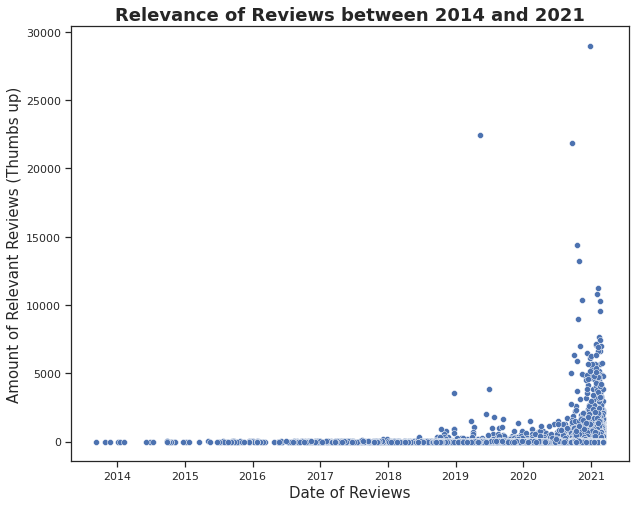

In [60]:
# Plot the Relevance of Reviews between 2014 and 2021 in relation to the "Thumbs Up" score
 
# Set figure size (width, height) in inches 
plt.figure(figsize = ( 10 , 8 )) 
  
# Plot scatterplot 
sns.scatterplot( x = "date" , y = "thumbsupcount" , data = df , palette='YlGnBu_r') 
  
# Set label for x-axis 
plt.xlabel(  "Date of Reviews" , size = 15 ) 
  
# Set label for y-axis 
plt.ylabel("Amount of Relevant Reviews (Thumbs up)" , size = 15 ) 
  
# Set title for figure 
plt.title( "Relevance of Reviews between 2014 and 2021" , size = 18, fontweight = 'bold' ) 
  
# Display figure 
plt.show() 

#### Preliminary Conclusions 
 1. The Distribution of Reviews between 2014 and 2021 shows a high imbalanced dataset having as a reference the date of the reviews. This fact may play a major role in analyzing the polarity of a particular app in a specific period. One option should be to achieve the analysis using a subset of the reviews posted between 2018 and 2021.


2. The processing and cleaning of data affected the temporal relation of the data. This may explain the considering amount of reviews missing in the plot about the Distribution of Reviews between 2014 and 2021.


3. The Relevance of Reviews between 2014 and 2021 presents more than 8 reviews with more than 10000 “Thumbs Up.” This need to be checked in order to consider the "Thumbs Up" feature for future analysis.


4. To the aim of this project, we will focus only in the features related to the reviews’text: appid, lemmatized and label (the target).


### 4. Dealing with the Polarity of Reviews' Text


The polarity categorized a text having a positive or a negative meaning regarding a score, a float between -1.0 and 1.0. 
* Positive polarity: 1.0 
* Negative polarity: -1.0 


In [61]:
# Calculate the polarity of all reviews using the "polarity dictionary" of textblob

from textblob import TextBlob

df['polarity'] = df['lemmatized'].apply(lambda x:TextBlob(x).sentiment.polarity)

In [62]:
df.head(3)

,score,thumbsupcount,appid,lemmatized,label,date,polarity
0,1,881,Google Chrome,get update chrome stop work reason try clear c...,Negative,2021-03-05,-0.350000
1,1,570,Google Chrome,love group tab illogical add extra click want ...,Negative,2021-03-06,-0.100000
2,1,31,Google Chrome,super happy chrome android change immediately ...,Negative,2021-03-05,0.185606


In [63]:
# Check random reviews with Highest Polarity

for index,review in enumerate(df.iloc[df['polarity'].sort_values(ascending=False)[:3].index]['lemmatized']):
    print('Review {}:\n'.format(index+1),review)

Review 1:
 app good install immidetly ask buy coin bad thing app
Review 2:
 lot well video chat call
Review 3:
 business account peacefully month small business easy suddenly login register regular whatsapp late chat history go thoughh thrice week


In [64]:
# Check random reviews with Lowest Polarity

for index,review in enumerate(df.iloc[df['polarity'].sort_values(ascending=True)[:3].index]['lemmatized']):
    print('Review {}:\n'.format(index+1),review)

Review 1:
 work fine fb messenger app difference think take space choose lite version
Review 2:
 connect
Review 3:
 overall good browser gap ui type specific result find instead get result similar thing expect blank page make bit rubbush user experience know exactly look use generic search term time


In [65]:
# Compare the Polarity of the reviews for each app

app_polarity_sorted=pd.DataFrame(df.groupby('appid')['polarity'].mean().sort_values(ascending=True))

In [66]:
app_polarity_sorted.head()

,polarity
appid,
Plato-Games,0.045362
LINE-Free Calls,0.075666
Google Chrome,0.084312
Chatruletka,0.085188
Messenger,0.108102


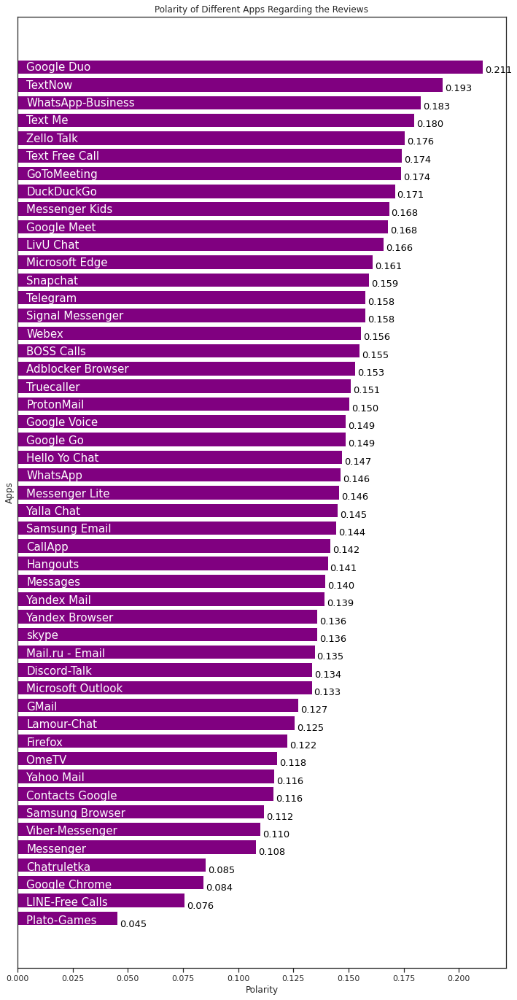

In [70]:
# plot the polarity of each app

plt.figure(figsize=(12,24))
plt.xlabel('Polarity')
plt.ylabel('Apps')
plt.title('Polarity of Different Apps Regarding the Reviews')
polarity_graph=plt.barh(np.arange(len(app_polarity_sorted.index)),app_polarity_sorted['polarity'], color='purple',)

# Writing product names on bar
for bar,product in zip(polarity_graph,app_polarity_sorted.index):
    plt.text(0.004,bar.get_y()+bar.get_width(),'{}'.format(product),fontsize=15,color='white')

# Writing polarity values on graph
for bar,polarity in zip(polarity_graph,app_polarity_sorted['polarity']):
    plt.text(bar.get_width()+0.001,bar.get_y()+bar.get_width(),'%.3f'%polarity,va='center',fontsize=13,color='black')

plt.yticks([])
plt.show()

### Check the polarity of the reviews for the users of each app


* **High polarity: greater acceptance of the reviews for the user of an app. The users find the reviews helpful.**

* This can help us to characterize the community (users) that use the apps.

    

In [71]:
thumbsupcount_percentage=pd.DataFrame(((df.groupby('appid')['thumbsupcount'].sum()*100)/df.groupby('appid')['thumbsupcount'].count()).sort_values(ascending=True))
thumbsupcount_percentage.head(2)

,thumbsupcount
appid,
Yandex Mail,226.538988
Samsung Email,379.072276


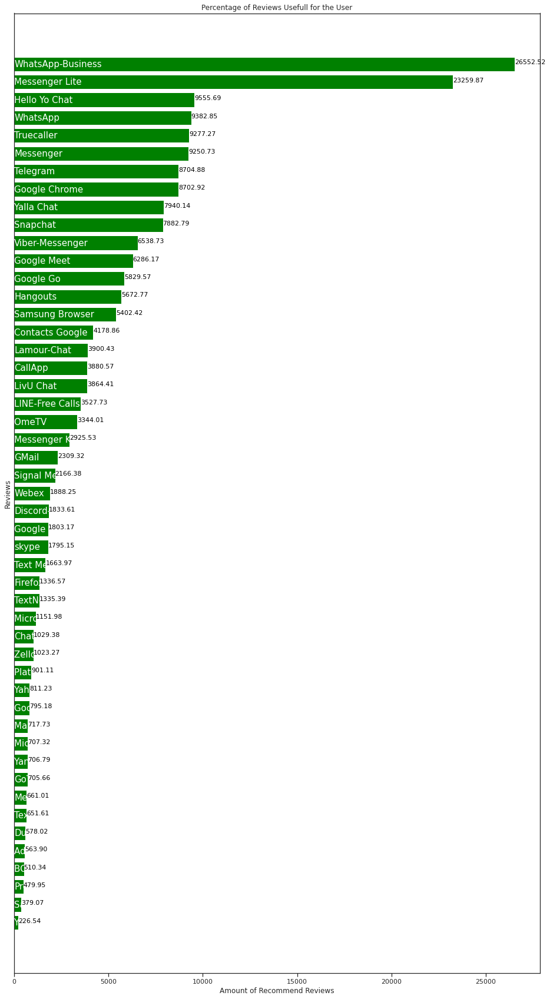

In [72]:
# Percentage of Reviews that users found useful
# This shows us which community is more active expressing the opinions in the GPS.  


plt.figure(figsize=(16,30))
plt.xlabel('Amount of Recommend Reviews')
plt.ylabel('Reviews')
plt.title('Percentage of Reviews Usefull for the User')
recommend_graph=plt.barh(np.arange(len(thumbsupcount_percentage.index)),thumbsupcount_percentage['thumbsupcount'],color='green')

# Writing product names on bar
for bar,product in zip(recommend_graph,thumbsupcount_percentage.index):
    plt.text(0.5,bar.get_y()+0.4,'{}'.format(product),va='center',fontsize=15,color='white')

# Writing recommendation percentage on graph
for bar,percentage in zip(recommend_graph,thumbsupcount_percentage['thumbsupcount']):
    plt.text(bar.get_width()+0.5,bar.get_y()+0.4,'%.2f'%percentage,fontsize=11,color='black')

plt.yticks([])
plt.show()


### 5. Dealing with the Representative Words in Reviews' Text



In [74]:
# create a dataframe with the appid and the lematized text

text = df[["appid", "lemmatized", "label"]].groupby(by=["appid", "label"]).agg(lambda x: " ".join(x))

text.head(50)

lemmatized
appid             label                                                      
Adblocker Browser Negative  work great recently app crash opening pixel re...
                  Neutral   app great week ago block happen like video go ...
                  Positive  app kind chatty little frustrating design bloc...
BOSS Calls        Negative  receive verification msg verify number transfe...
                  Neutral   app easy use easy recharge credit card informa...
                  Positive  great long distance rate go international netw...
CallApp           Negative  call record record call voice inform time feel...
                  Neutral   good interface usability pay version app clunk...
                  Positive  confusing screen pop know advertisement phone ...
Chatruletka       Negative  bad app world highly recommend instal app work...
                  Neutral   good app young guy wish like sort filter gende...
                  Positive  app nice button little disappointed hand touch...
Contacts Google   Negative  attempt numerous time contact google avail acc...
                  Neutral   great simple use problem samsung dual messenge...
                  Positive  recent update state get hang check search cont...
Discord-Talk      Negative  love app update mobile app perform like trash ...
                  Neutral   great app easy use rating lower issue consiste...
                  Positive  year highly useful communicate friend easily r...
DuckDuckGo        Negative  give app star love moment lately eat battery t...
                  Neutral   early render review comment future app literal...
                  Positive  like sense security search great fast battery ...
Firefox           Negative  firefox android year today spontaneously stop ...
                  Neutral   like browser think secure place surf web eye p...
                  Positive  love browser thing consider fester wound defau...
GMail             Negative  worthless spend countless hour search activate...
                  Neutral   double check area request set properly get cou...
                  Positive  gmail year suddenly problem reply email keyboa...
GoToMeeting       Negative  awful experience log try time log web browser ...
                  Neutral   easy access meeting operate log etc sound qual...
                  Positive  app work smoothly general challenge glitching ...
Google Chrome     Negative  get update chrome stop work reason try clear c...
                  Neutral   tab group month experimental feature ui diffic...
                  Positive  actually grow love app bell whistle originally...
Google Duo        Negative  love duo use time face chat friend reason lowe...
                  Neutral   app month message say deliver say send think g...
                  Positive  truly great app enjoy video chat friend family...
Google Go         Negative  depict alternative google app google app assis...
                  Neutral   nice app text speech constantly stop option st...
                  Positive  love favorite feature google read screen aloud...
Google Meet       Negative  oh wish star record session use google meet ch...
                  Neutral   hope innovate app use hour day online class me...
                  Positive  perfect app teacher student view perfect their...
Google Voice      Negative  okay concept idea app great especially reliabl...
                  Neutral   google voice create available favorite app rec...
                  Positive  wish google voice let block area code set whit...
Hangouts          Negative  year connect family special share page update ...
                  Neutral   leave app star rating change friend create new...
                  Positive  love app need thing screen share phone laptop ...
Hello Yo Chat     Negative  app fun use specially killing time host differ...
                  Neutral   app decent nice way kill time socialise thing ...

In [75]:
text_df = text.reset_index()  

In [76]:
text_df.head(0)

,appid,label,lemmatized
0,Adblocker Browser,Negative,work great recently app crash opening pixel re...
1,Adblocker Browser,Neutral,app great week ago block happen like video go ...
2,Adblocker Browser,Positive,app kind chatty little frustrating design bloc...
3,BOSS Calls,Negative,receive verification msg verify number transfe...
4,BOSS Calls,Neutral,app easy use easy recharge credit card informa...
5,BOSS Calls,Positive,great long distance rate go international netw...
6,CallApp,Negative,call record record call voice inform time feel...
7,CallApp,Neutral,good interface usability pay version app clunk...
8,CallApp,Positive,confusing screen pop know advertisement phone ...
9,Chatruletka,Negative,bad app world highly recommend instal app work...


In [96]:
# create a new column with the total of words in reviews refarding the label
#https://stackoverflow.com/questions/42815768/pandas-adding-column-with-the-length-of-other-column-as-value

text_df["words"] = text_df["lemmatized"].apply(lambda x: len(x))

In [97]:
text_df

,appid,label,lemmatized,words
0,ch.protonmail.android,Negative,ready public release lack basic functionality ...,34765
1,ch.protonmail.android,Neutral,rating service service awesome feature android...,29396
2,ch.protonmail.android,Positive,protonmail waaaaay day ready prime time sadly ...,21414
3,com.android.chrome,Negative,get update chrome stop work reason try clear c...,44559
4,com.android.chrome,Neutral,tab group month experimental feature ui diffic...,30794
...,...,...,...,...
145,sg.bigo.hellotalk,Neutral,good child good adult recommend remove bad ima...,4226
146,sg.bigo.hellotalk,Positive,app long time like app audio driver singe song...,10845
147,sg.bigo.live,Negative,app fun use specially killing time host differ...,30265
148,sg.bigo.live,Neutral,app decent nice way kill time socialise thing ...,18342


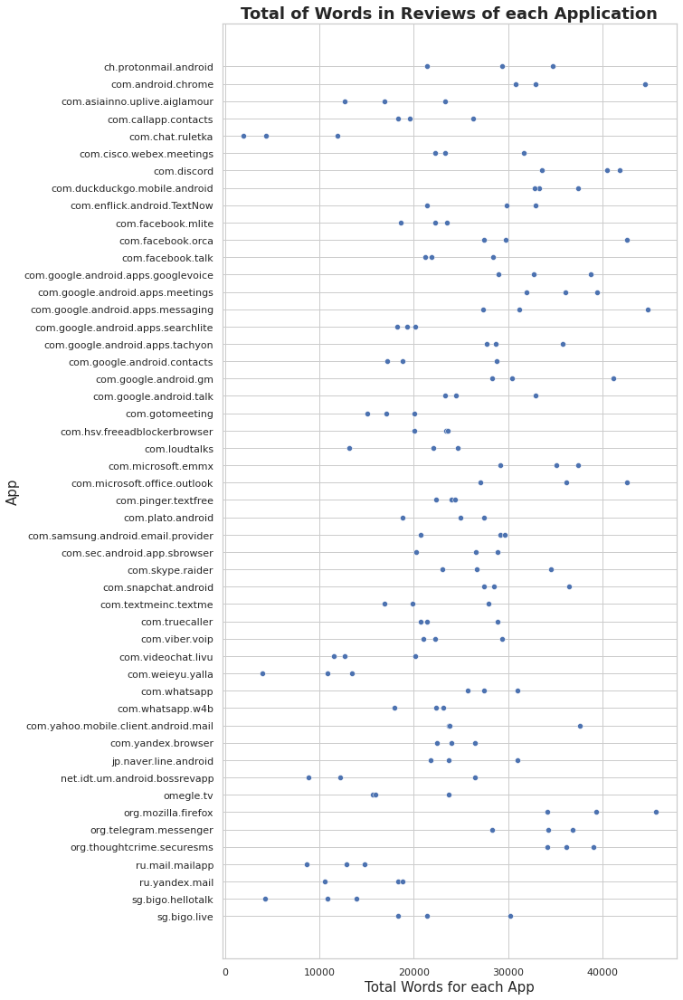

In [104]:
# Plot the amount of words in each target (Positive, Neutral, Negative) regarding each app. 


# Set figure size (width, height) in inches 
plt.figure(figsize = ( 9 , 19 )) 
  
# Plot scatterplot 
sns.scatterplot( x = "words" , y = "appid" , data = text_df , palette='YlGnBu_r') 
  
# Set label for x-axis 
plt.xlabel(  "Total Words for each App" , size = 15 ) 
  
# Set label for y-axis 
plt.ylabel("App" , size = 15 ) 
  
# Set title for figure 
plt.title( "Total of Words in Reviews of each Application" , size = 18, fontweight = 'bold' ) 
  
# Display figure 
plt.show() 

### Preliminary Conclusion 
1. This plot shows a strong imbalance relation among the apps regarding the amount of word in each app. i.e. Apps like Protonmail will have more word (between 20000 and 40000) for the analysis in relation to Yandex-Mail (between 10000 and 20000).


2. This should be consider for future analysis.  


In [88]:
# Check amount of texts classified as Negative (Target) 

text_df[text_df["label"]== "Negative"]["lemmatized"]

0      ready public release lack basic functionality ...
3      get update chrome stop work reason try clear c...
6      hello guy fake waste time money suggest save m...
9      call record record call voice inform time feel...
12     bad app world highly recommend instal app work...
15     buy new chromebook acer excited great piece ha...
18     love app update mobile app perform like trash ...
21     give app star love moment lately eat battery t...
24     don t use app real issue app make look text me...
27     time try watch video send chat screen show bla...
30     new android update absolute garbage bubble sma...
33     wo nt let child gmail facebook account child b...
36     okay concept idea app great especially reliabl...
39     oh wish star record session use google meet ch...
42     week download mms message constant message exp...
45     depict alternative google app google app assis...
48     love duo use time face chat friend reason lowe...
51     attempt numerous time co

In [105]:
from wordcloud import WordCloud
from textwrap import wrap

In [106]:
# Creating Document Term Matrix for Positives
from sklearn.feature_extraction.text import CountVectorizer

cv=CountVectorizer(analyzer='word')
data_p=cv.fit_transform(text_df[text_df["label"] == "Positive"]['lemmatized'])
df_dtm_p = pd.DataFrame(data_p.toarray(), columns=cv.get_feature_names())
df_dtm_p.index=text_df[text_df["label"] == "Positive"]["appid"]

In [107]:
# Creating Document Term Matrix for Negatives
from sklearn.feature_extraction.text import CountVectorizer

cv=CountVectorizer(analyzer='word')
data=cv.fit_transform(text_df[text_df["label"] == "Negative"]['lemmatized'])
df_dtm_n = pd.DataFrame(data.toarray(), columns=cv.get_feature_names())
df_dtm_n.index=text_df[text_df["label"] == "Negative"]["appid"]

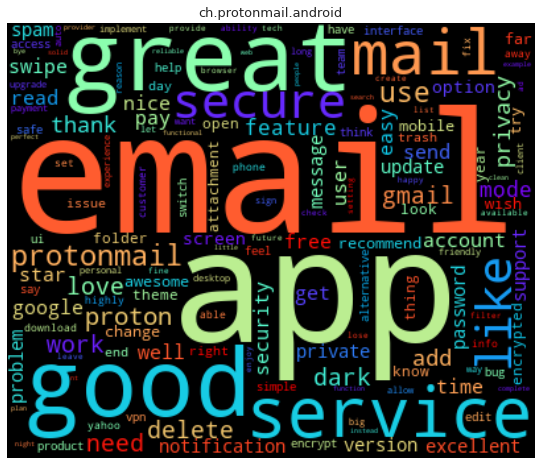

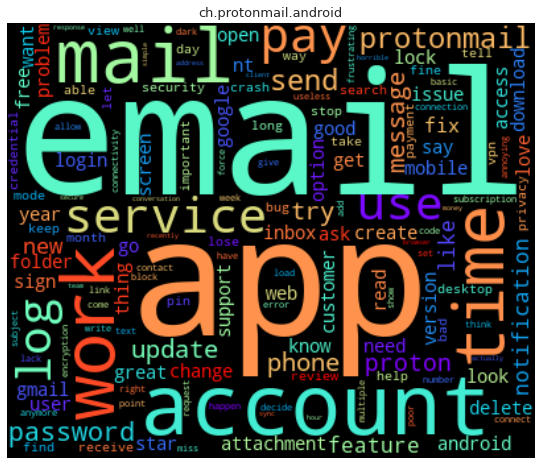

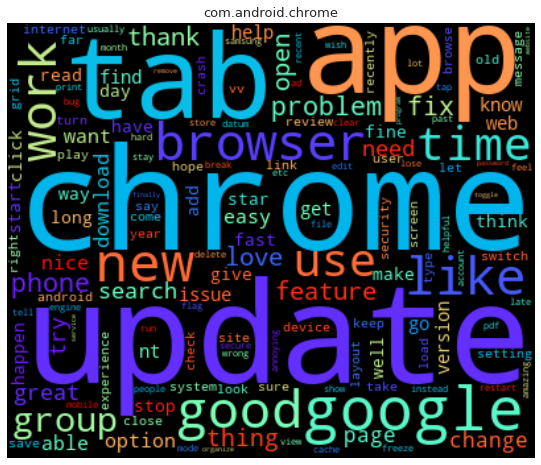

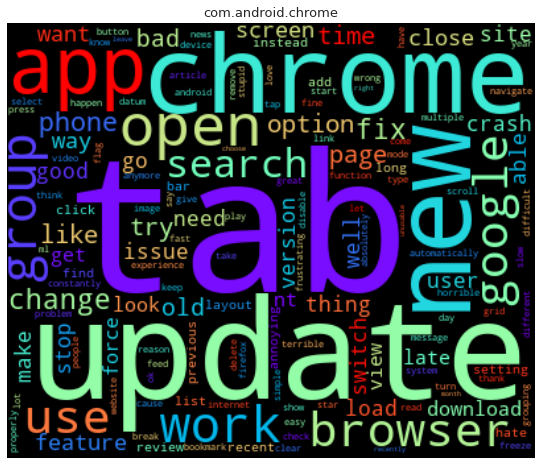

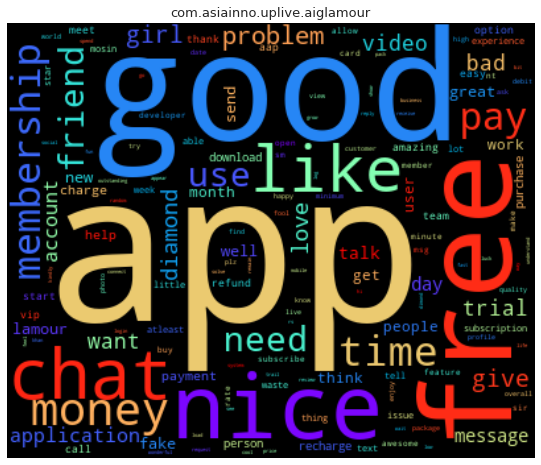

...

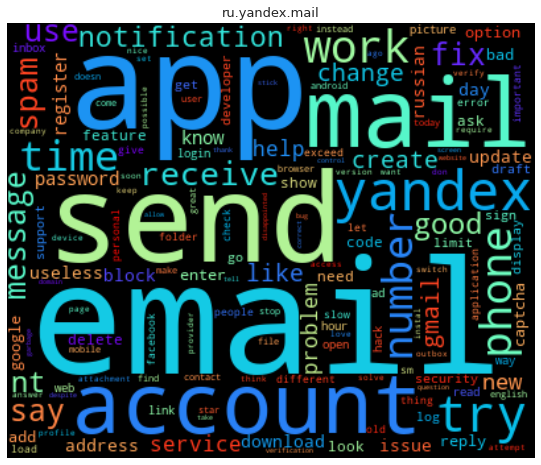

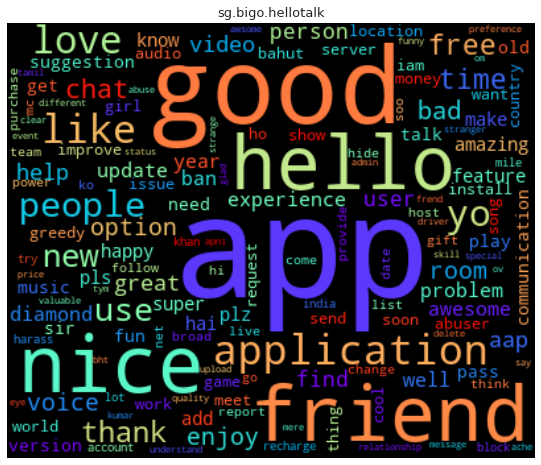

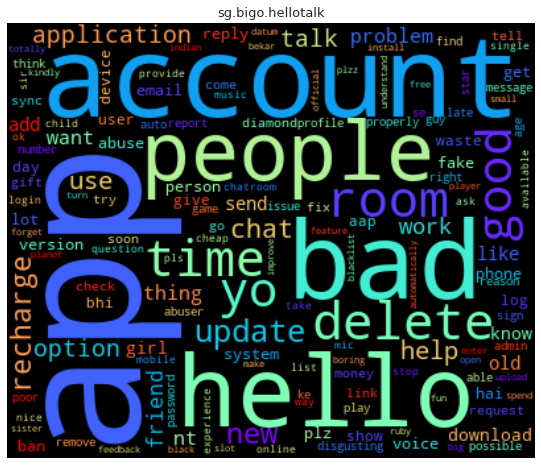

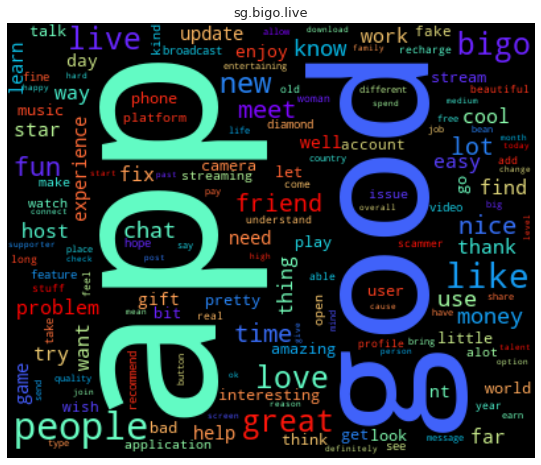

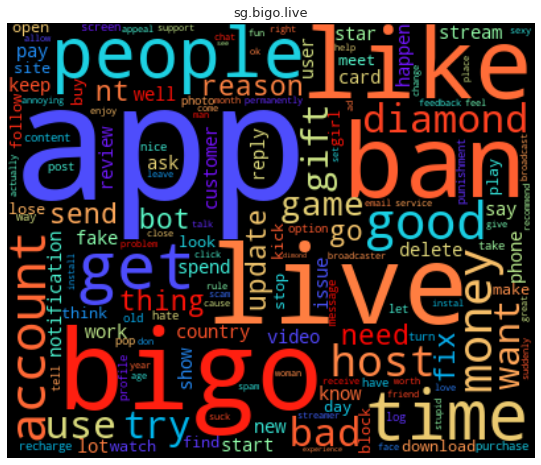

In [108]:
# Plot the Word Clouds related to the most representative words in the reviews with positive and negative target from each app.

# Importing wordcloud for plotting word clouds and textwrap for wrapping longer text
from wordcloud import WordCloud
from textwrap import wrap

# Function for generating word clouds     colomap="Blues"
def generate_wordcloud(data,title):
    wc = WordCloud(width=400, height=330, max_words=150,colormap="rainbow").generate_from_frequencies(data)
    plt.figure(figsize=(10,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")
    plt.title('\n'.join(wrap(title,60)),fontsize=13)
    plt.show()

# Transposing document term matrix
df_dtm_n=df_dtm_n.transpose()
df_dtm_p=df_dtm_p.transpose()

# Plotting word cloud for each product

for product_1, product_2 in zip(df_dtm_p.columns, df_dtm_n.columns):
    generate_wordcloud(df_dtm_p[product_1].sort_values(ascending=False),product_1)
    generate_wordcloud(df_dtm_n[product_2].sort_values(ascending=False),product_2)

### Preliminary Conclusion 
The Word Clouds give us the most representative words in the positive and negative reviews in each app. 
The words in the Word Clouds  help us to characterize the values, needs and features the users use to associate an app and therefore give us meaningful insights to set more specific research of user reviews and additional strategies to improve users perception of the apps.  

# Sources

https://textblob.readthedocs.io/en/dev/quickstart.html
https://planspace.org/20150607-textblob_sentiment/
https://rdrr.io/cran/sentimentr/man/sentiment.html
https://nlp.stanford.edu/courses/cs224n/2009/fp/24.pdf
https://stackoverflow.com/questions/10059594/a-simple-explanation-of-naive-bayes-classification

https://www.analyticsvidhya.com/blog/2020/04/beginners-guide-exploratory-data-analysis-text-data/
